# Lab 4: Video enhancement

This lab is focused on two different aspects of video restoration or enhancement: denoising and stabilization.

## Objectives

* Create a naive video denoising method with motion-compensated frames.
* Gain a practical understanding of the Non-Local Means denoising algorithm.
* Visualize and understand the effects of different choices of parameters.
* Gain a practical understanding of the compositional smoothing algorithm for video stabilization.

## Deliverable

**Deadline**: <span style="color:red">P101: 28/02/23 at 10:30h - P102: 01/03/23 at 12:30h</span>

**Submission**:
* The completed Jupyter Notebook with executed cells (all cells must work, i.e. they should run).
* A report with your work, including missing codes and answers to the lab questions (analysis of results, influence of parameters, etc). Address all tasks marked as <font color='green'>**TX.**</font>
* Submit a single zip file in the corresponding delivery task in Aula Global. The submitted zip file has to contain your report and your source code (and all files needed to run it, such as images, other dependencies, etc). The lab will be done in groups of two persons, please submit a single file per group.


## Colab Setup

After uploading and unzipping the files in your **Google Drive**, mount them  in **Colab**:

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Change the execution path to your lab directory path.

In [ ]:
import os

LAB4_DIRPATH = '/content/drive/Shareddrives/VIDEO PROC 3.0/LAB4'
os.chdir(LAB4_DIRPATH)

In [ ]:
import sys
sys.path.insert(1,'/content/drive/Shareddrives/VIDEO PROC 3.0/LAB4')

**OPTIONAL**. If you are planning to use `write_gray_video` function from `utils.py`, run the following command to install the needed video packages and its dependencies:

In [ ]:
!apt install ffmpeg
!pip install scikit-video

Reading package lists... Done
Building dependency tree       
Reading state information... Done
ffmpeg is already the newest version (7:4.2.7-0ubuntu0.1).
0 upgraded, 0 newly installed, 0 to remove and 19 not upgraded.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 26.1 MB/s eta 0:00:00


## Part I: Video denoising

This first part of the lab is devoted to video denoising. We will start by a naive video denoising strategy that uses motion compensation. Then we will use the Non-Local Means (NL-means) algorithm [1,2] and will analyse the impact of its parameters.

[1] A. Buades, B. Coll, J.-M. Morel. Image and movie denoising by nonlocal means. Int. Journal of Comp. Vision, 76(2), 2008.

[2] A. Buades, B. Coll, J.-M. Morel. Non-Local Means Denoising. Image Processing On Line, 2011. https://www.ipol.im/pub/art/2011/bcm_nlm/

Let's start by watching the first video you will work with. It is a static background with some moving foreground objects filmed with a fixed camera.

In [ ]:
from utils import display_video

display_video('videos/wednesday_cut.mp4', width=640, height=360)

The following cell reads a video and stores it in a list of grayscale frames, then adds white Gaussian noise.

In [ ]:
import numpy as np
import cv2
from matplotlib import pyplot as plt
from utils import add_noise, read_gray_video, write_gray_video, write_gray_video2

# read the video in a list of grayscale frames
gray_frames = read_gray_video('videos/wednesday_cut.mp4')

# add random noise (normal distribution with zero mean and std=15)
np.random.seed(42)
noisy_frames = add_noise(gray_frames, 15)

# write the noisy video (you can either use 'write_gray_video' or 'write_gray_video2')
write_gray_video('wednesday_cut.mp4', noisy_frames, 25)

display_video('wednesday_cut.mp4', width=640, height=360)
# in case video doesn't play here (may happen if you use 'write_gray_video2') play it externally

The following code writes all the frames of the original and noisy video.

In [ ]:
!mkdir -p frames_part1
filename = 'frames_part1/gray_frames{0}.jpg'
filename2 = 'frames_part1/noisy_frames{0}.jpg'
for i in range(len(gray_frames)):
    cv2.imwrite(filename.format(i), gray_frames[i])
    cv2.imwrite(filename2.format(i), noisy_frames[i])

### I.1.  Naive video denoising
A naive video denoising consists of averaging temporally every pixel with a temporal window of lenght $2m+1$.

<font color='green'>**T1.** Create a denoised version of the 16th frame (i.e. `noisy_frames[15]`) by naive temporal averaging of the pixels (you can use the function `np.mean`). Change the value of `m` (use 2, 4 and 6) and comment its impact on the results, identify the benefits and the pitfalls.</font>

<font color='green'>**OPTIONAL.** Denoise the whole video by temporal averaging.</font>

DENOISING THE 16TH FRAME


In [ ]:
n = 15 #agafem el frame 15 ja que es n+1 = 16
m = 2
temporal_average_m2 = np.mean(noisy_frames[n-m:n+m+1], axis=0)
cv2.imwrite('wednesday_cut_temporal_average_m2.jpg', temporal_average_m2)
m = 4
temporal_average_m4 = np.mean(noisy_frames[n-m:n+m+1], axis=0)
cv2.imwrite('wednesday_cut_temporal_average_m4.jpg', temporal_average_m4)
m = 6
temporal_average_m6 = np.mean(noisy_frames[n-m:n+m+1], axis=0)
cv2.imwrite('wednesday_cut_temporal_average_m6.jpg', temporal_average_m6)

#Calculem el soroll
psnr= cv2.PSNR(gray_frames[15].astype(np.float64), temporal_average_m2.astype(np.float64))
print('psnr m = 2: ' , psnr)
psnr= cv2.PSNR(gray_frames[15].astype(np.float64), temporal_average_m4.astype(np.float64))
print('psnr m = 4: ' , psnr)
psnr= cv2.PSNR(gray_frames[15].astype(np.float64), temporal_average_m6.astype(np.float64))
print('psnr m = 6: ' , psnr)


psnr m = 2:  24.381369754569665
psnr m = 4:  23.599279326830263
psnr m = 6:  23.009066919851257


**OPTIONAL**: DENOISING THE WHOLE VIDEO

In [ ]:
#donem valor a m
m = 2
n = np.shape(noisy_frames)[0]

#denoising the whole video
denoised_temp_averag = []
for i in range(m,n-m-1):
    start = i-m
    end = i+m+1
    temporal_average = np.mean(noisy_frames[start:end],axis = 0)
    denoised_temp_averag.append(temporal_average)

denoised_temp_averag = np.asarray(denoised_temp_averag,dtype=np.uint8)

write_gray_video('wednesday_denoised_naive2.mp4', denoised_temp_averag, 25)
display_video('wednesday_denoised_naive2.mp4', width=480, height=360)

A better result can be obtained if we locally compensate the motion of the neighboring frames with respect to the target frame. For that we will estimate the optical flow with the TV-L1 algorithm and we will compensate the motion with the `warp_image_flow` function of lab 3.

<font color='green'>**T2.** As a first step towards this second naive method you will write the code that takes the 16th frame as target frame and computes the 2 previous and 2 posterior motion-compensated frames. Write the 5 frames as images and visualize them one after the other, you can also compute the difference of each frame with respect to the central (target) frame. Comment the results. </font>

In [ ]:
import math
   
def warp_image_flow(image, flow):    
    h, w = flow.shape[:2]    
    flow = flow.astype(np.float32)
    flow[..., 0] += np.arange(w)
    flow[..., 1] += np.arange(h)[:, np.newaxis]    
    warped_image = cv2.remap(image, flow[..., 0], flow[..., 1], cv2.INTER_LINEAR)    
    return warped_image

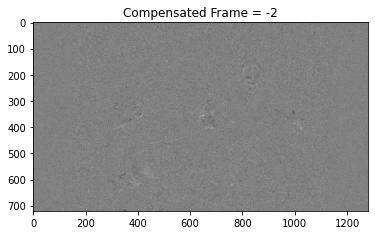

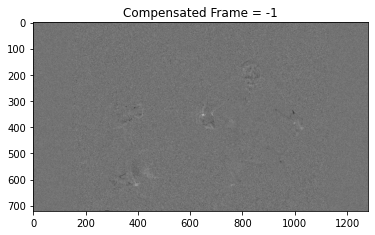

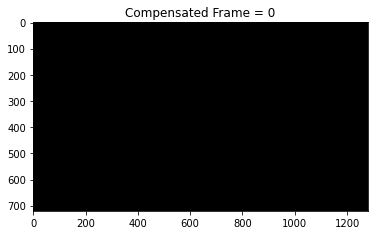

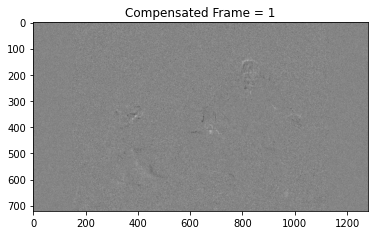

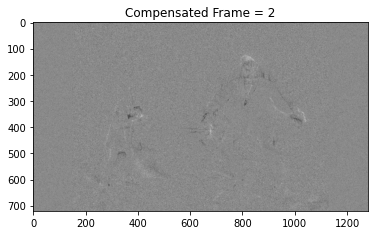

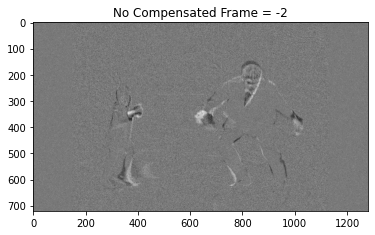

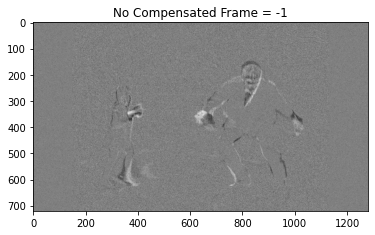

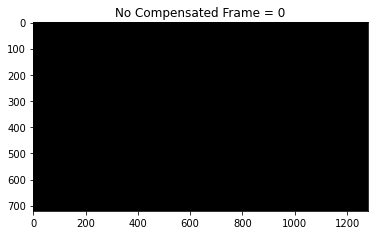

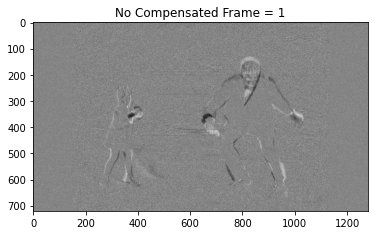

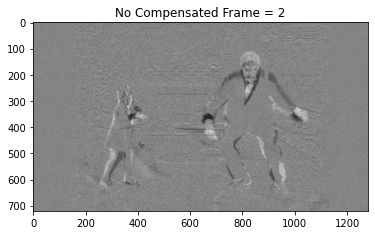

In [ ]:
n = 15 #frame n+1 = 16
ref_frame = noisy_frames[n]
I1 = ref_frame;
differenceWarped = []
differenceNoWarped = []
compensated_frames = []
optical_flow = cv2.optflow.createOptFlow_DualTVL1()

m = 2
for i in range(-m,m+1): #estem agafant el rang de -2 a 2
  I2 = noisy_frames[n+i]
  flow = optical_flow.calc(I1, I2, None)
  I_warped = warp_image_flow(I2, flow)
  compensated_frames.append(np.int32(I_warped))
  differenceWarped.append(np.int32(I_warped) - np.int32(I1))
  differenceNoWarped.append(np.int32(I2) - np.int32(I1))

#Mostrem 
for i in range(-m, m+1):
  plt.imshow(differenceWarped[i+2], cmap='gray')
  plt.title('Compensated Frame = %d' %(i))
  plt.show()

for i in range(-m, m+1):
  plt.imshow(differenceNoWarped[i+2], cmap='gray')
  plt.title('No Compensated Frame = %d' %(i))
  plt.show()

<font color='green'>**T3.** Extend the previous code so as to denoise the frames 15th, 16th and 17th by temporal averaging in a temporal window of $2m+1$ motion-compensated frames. Try different values of `m` and compare the result with respect to the first naive method. </font>

No Comp frame = 0  :  24.713022077605096
Comp frame = 0  :  29.593612144108732
No Comp frame = 1  :  24.39269396877766
Comp frame = 1  :  29.490456733252884
No Comp frame = 2  :  24.10897252310641
Comp frame = 2  :  29.442522862348483


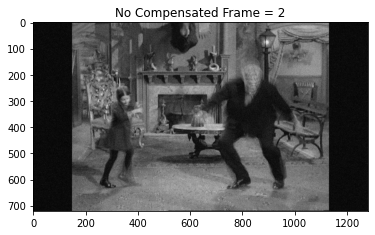

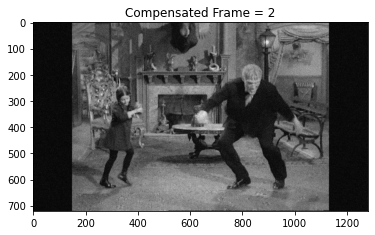

In [ ]:
m = 2
denoised_temporal_comp = []
denoised_temporal = []
for i in range(14,17):
    comp_frames_aux = [];
    I1 = noisy_frames[i]
    for j in range(-m,m+1):
        I2 = noisy_frames[i+j]
        flow = optical_flow.calc(I1, I2, None)
        I_warped = warp_image_flow(I2, flow)
        comp_frames_aux.append(np.int32(I_warped))
    
    temporal_average_comp = np.mean(comp_frames_aux, axis=0)
    temporal_average = np.mean(noisy_frames[i-m:i+m+1], axis=0)
    denoised_temporal_comp.append(np.uint8(temporal_average_comp))
    denoised_temporal.append(np.uint8(temporal_average))

#Comparem el soroll de cada frame

for i in range(3):
    cv2.imwrite('ex3_Frame'+str(14+i)+'.jpg', denoised_temporal[i])
    psnr= cv2.PSNR(gray_frames[14+i].astype(np.float64), denoised_temporal[i].astype(np.float64))
    print('No Comp frame = %d' % (i), ' : ', psnr)
    cv2.imwrite('ex3_Frame'+str(14+i)+'Comp.jpg',denoised_temporal_comp[i])
    psnr= cv2.PSNR(gray_frames[14+i].astype(np.float64),denoised_temporal_comp[i].astype(np.float64))
    print('Comp frame = %d' % (i), ' : ', psnr)

plt.imshow(denoised_temporal[0],cmap='gray')
plt.title('No Compensated Frame = %d' % (i))
plt.show()

plt.imshow(denoised_temporal_comp[0],cmap='gray')
plt.title('Compensated Frame = %d' % (i))
plt.show()

No Comp frame = 0  :  23.69700769556914
Comp frame = 0  :  29.197914619910676
No Comp frame = 1  :  23.607816836391457
Comp frame = 1  :  29.1889266384517
No Comp frame = 2  :  23.40929525938353
Comp frame = 2  :  29.09672615429941


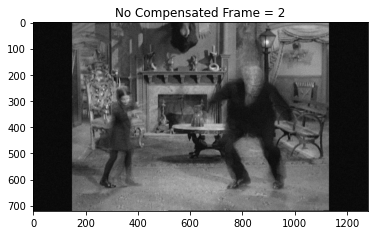

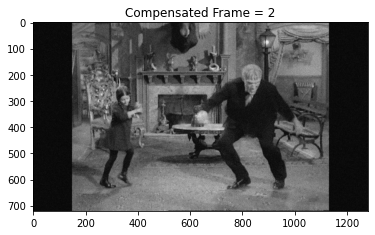

In [ ]:
m = 4
denoised_temporal_comp = []
denoised_temporal = []
for i in range(14,17):
    comp_frames_aux = [];
    I1 = noisy_frames[i]
    for j in range(-m,m+1):
        # if j == 0:
        #     compensated_frames_aux.append(noisy_frames[i]);
        I2 = noisy_frames[i+j]
        flow = optical_flow.calc(I1, I2, None)
        I_warped = warp_image_flow(I2, flow)
        comp_frames_aux.append(np.int32(I_warped))
    
    temporal_average_comp = np.mean(comp_frames_aux, axis=0)
    temporal_average = np.mean(noisy_frames[i-m:i+m+1], axis=0)
    denoised_temporal_comp.append(np.uint8(temporal_average_comp))
    denoised_temporal.append(np.uint8(temporal_average))

#Comparem el soroll de cada frame

for i in range(3):
    cv2.imwrite('ex3_Frame'+str(14+i)+'.jpg', denoised_temporal[i])
    psnr= cv2.PSNR(gray_frames[14+i].astype(np.float64), denoised_temporal[i].astype(np.float64))
    print('No Comp frame = %d' % (i), ' : ', psnr)
    cv2.imwrite('ex3_Frame'+str(14+i)+'Comp.jpg',denoised_temporal_comp[i])
    psnr= cv2.PSNR(gray_frames[14+i].astype(np.float64),denoised_temporal_comp[i].astype(np.float64))
    print('Comp frame = %d' % (i), ' : ', psnr)

plt.imshow(denoised_temporal[0],cmap='gray')
plt.title('No Compensated Frame = %d' % (i))
plt.show()

plt.imshow(denoised_temporal_comp[0],cmap='gray')
plt.title('Compensated Frame = %d' % (i))
plt.show()

In [ ]:
m = 6
denoised_temporal_comp = []
denoised_temporal = []
for i in range(14,17):
    comp_frames_aux = [];
    I1 = noisy_frames[i]
    for j in range(-m,m+1):
        # if j == 0:
        #     compensated_frames_aux.append(noisy_frames[i]);
        I2 = noisy_frames[i+j]
        flow = optical_flow.calc(I1, I2, None)
        I_warped = warp_image_flow(I2, flow)
        comp_frames_aux.append(np.int32(I_warped))
    
    temporal_average_comp = np.mean(comp_frames_aux, axis=0)
    temporal_average = np.mean(noisy_frames[i-m:i+m+1], axis=0)
    denoised_temporal_comp.append(np.uint8(temporal_average_comp))
    denoised_temporal.append(np.uint8(temporal_average))

#Comparem el soroll de cada frame

for i in range(3):
    cv2.imwrite('ex3_Frame'+str(14+i)+'.jpg', denoised_temporal[i])
    psnr= cv2.PSNR(gray_frames[14+i].astype(np.float64), denoised_temporal[i].astype(np.float64))
    print('No Comp frame = %d' % (i), ' : ', psnr)
    cv2.imwrite('ex3_Frame'+str(14+i)+'Comp.jpg',denoised_temporal_comp[i])
    psnr= cv2.PSNR(gray_frames[14+i].astype(np.float64),denoised_temporal_comp[i].astype(np.float64))
    print('Comp frame = %d' % (i), ' : ', psnr)

plt.imshow(denoised_temporal[0],cmap='gray')
plt.title('No Compensated Frame = %d' % (i))
plt.show()

plt.imshow(denoised_temporal_comp[0],cmap='gray')
plt.title('Compensated Frame = %d' % (i))
plt.show()

### I.2.  Non-Local means
Let's start by denoising each frame independently with the Non-Local algorithm. Execute the following cell.

In [ ]:
# denoise each frame independently with the NL-means method
denoised_indep = [cv2.fastNlMeansDenoising(i,None,20,7,21) for i in noisy_frames] 

# write denoised video (you can either use 'write_gray_video' or 'write_gray_video2')
write_gray_video('wednesday_denoised_indep.mp4', denoised_indep, 25)

display_video('wednesday_denoised_indep.mp4', width=640, height=360)

Now we will denoise each frame taking into account not only the similar patches inside the current frame but also in the two previous and posterior frames.

In [ ]:
# denoise video taking into account previous and posterior frames
T = 5 
T_half = T // 2
denoised_frames = []

for t in range(T_half,len(noisy_frames)-T_half): # we avoid processing the first and last T frames
    denoised_frames.append(cv2.fastNlMeansDenoisingMulti(noisy_frames, t, T, None, 20, 7, 21))
    
write_gray_video('wednesday_denoised_video.mp4', denoised_frames, 25)

display_video('wednesday_denoised_video.mp4', width=640, height=360)

The [Peak signal-to-noise ratio (PSNR)](https://en.wikipedia.org/wiki/Peak_signal-to-noise_ratio) is a standard measure to quantitatively evaluate a denoising method. It is basically the Mean Square Error between the clean and denoised images. The following code computes the PSNR of the denoised 16th frame for the two previous variants of denoising with the Non-local means algorithm.

In [ ]:
psnr_1 = cv2.PSNR(gray_frames[15].astype(np.float64), denoised_frames[15-2].astype(np.float64))
print(psnr_1)
psnr_2 = cv2.PSNR(gray_frames[15].astype(np.float64), denoised_indep[15].astype(np.float64))
print(psnr_2)

<font color='green'>**T4.** Compute the PSNR of the four denoised versions of frame 16th (obtained with the four different denoising methods). Compare the results and comment.</font>

Multi:  26.86151078475351
Spacial:  28.50131268511565
Naive:  24.39269396877766
Compensated:  29.490456733252884


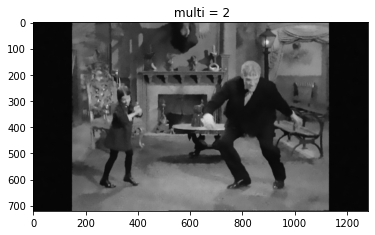

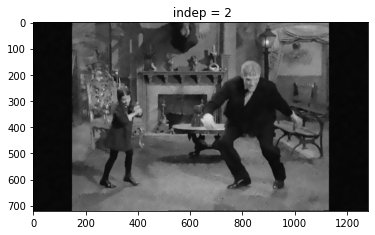

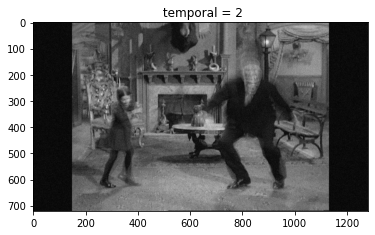

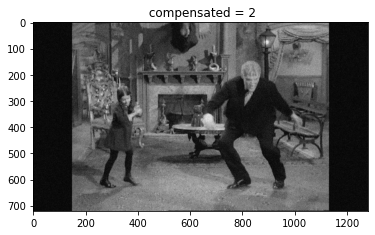

In [ ]:
#calculem el psnr pels 4 metodes
psnr_1 = cv2.PSNR(gray_frames[15].astype(np.float64), denoised_frames[15-2].astype(np.float64))
print('Multi: ', psnr_1)

psnr_2 = cv2.PSNR(gray_frames[15].astype(np.float64), denoised_indep[15].astype(np.float64))
print('Spacial: ', psnr_2)

psnr_3 = cv2.PSNR(gray_frames[15].astype(np.float64), denoised_temporal[1].astype(np.float64))
print('Naive: ', psnr_3)

psnr_4 = cv2.PSNR(gray_frames[15].astype(np.float64),denoised_temporal_comp[1].astype(np.float64))
print('Compensated: ', psnr_4)

#fem el plot dels 4 metodes
plt.imshow(denoised_frames[15-2],cmap='gray')
plt.title(' multi = %d' % (i))
plt.show()
plt.imshow(denoised_indep[15],cmap='gray')
plt.title(' indep = %d' % (i))
plt.show()
plt.imshow(denoised_temporal[1],cmap='gray')
plt.title(' temporal = %d' % (i))
plt.show()
plt.imshow(denoised_temporal_comp[1],cmap='gray')
plt.title(' compensated = %d' % (i))
plt.show()

**Study of the parameter h**

Finally, you will study the effect of the parameter h, i.e. the value in the denominator of the exponent/power of the exponential.

In this [link](https://docs.opencv.org/3.4/d1/d79/group__photo__denoise.html#gaf4421bf068c4d632ea7f0aa38e0bf172) you can check the meaning of the different input variables to the video version of the Non-Local means algorithm (`cv2.fastNlMeansDenoisingMulti`).

The goal is to focus only on denoising the frame 16th. For that you will create a small video (subvideo) around frame 16th, i.e. from frame 15-4 to frame 15+4.

<font color='green'>**T5.** Try and explore different values of the parameter h (h = 20, 10, 8). Apply the algorithm to both the noisy subvideo and the warped noisy subvideo.  Comment and compare the results, both qualitatively and quantitatively.</font>

In [ ]:
T = 9
t = 15 #indice n + 1 = 16

#diferents casos per h = 8, 10, 20
#per cada un d'ells, calculem amb el metode Multi el denoised frame i la forma compensada
h = 8
denoised_h8 = cv2.fastNlMeansDenoisingMulti(noisy_frames, t, T, None, h, 5, 21)
denoised_compensated_h8 = cv2.fastNlMeansDenoisingMulti(np.uint8(compensated_frames), 2, 5, None, h, 7, 21)
#calculem el psnr pels dos casos de compensated i no compensated
psnr_h8 = cv2.PSNR(gray_frames[15].astype(np.float64), denoised_h8.astype(np.float64))
psnr_h8_comp = cv2.PSNR(gray_frames[15].astype(np.float64), denoised_compensated_h8.astype(np.float64))
print('PSNR h = 8: ', psnr_h8)
print('PSNR compensated h = 8: ', psnr_h8_comp)

h = 10
denoised_h10 = cv2.fastNlMeansDenoisingMulti(noisy_frames, t, T, None, h, 5, 21)
denoised_compensated_h10 = cv2.fastNlMeansDenoisingMulti(np.uint8(compensated_frames), 2, 5, None, h, 7, 21)
#calculem el psnr pels dos casos de compensated i no compensated
psnr_h10 = cv2.PSNR(gray_frames[15].astype(np.float64), denoised_h10.astype(np.float64))
psnr_h10_comp = cv2.PSNR(gray_frames[15].astype(np.float64), denoised_compensated_h10.astype(np.float64))
print('PSNR h = 10: ', psnr_h10)
print('PSNR compensated h = 10: ', psnr_h10_comp)


h = 20
denoised_h20 = cv2.fastNlMeansDenoisingMulti(noisy_frames, t, T, None, h, 5, 21)
denoised_compensated_h20 = cv2.fastNlMeansDenoisingMulti(np.uint8(compensated_frames), 2, 5, None, h, 7, 21)
#calculem el psnr pels dos casos de compensated i no compensated
psnr_h20 = cv2.PSNR(gray_frames[15].astype(np.float64), denoised_h20.astype(np.float64))
psnr_h20_comp = cv2.PSNR(gray_frames[15].astype(np.float64), denoised_compensated_h20.astype(np.float64))
print('PSNR h = 20: ', psnr_h20)
print('PSNR compensated  h = 20: ', psnr_h20_comp)

PSNR h = 8:  25.965037089721758
PSNR h = 10:  26.220101834097783
PSNR h = 20:  27.66340940376964
PSNR compensated h = 8:  25.927755975151317
PSNR compensated h = 10:  26.179822158807596
PSNR compensated  h = 20:  25.89176089661717


## Part II: Video stabilization

In this part we will focus on the compositional smoothing for video stabilization. It is a method based on the following steps:
- Feature-based motion estimation.
- Outlier removal through a RANSAC strategy (frame-to-frame analysis).
- Camera motion modeling by 2D models, in particular by a homography (2D projective transformation represented by a $3\times 3$ matrix.
- Camera motion correction by a low-pass filtering, in particular with a Gaussian filter (compositional smoothing).
- Video synthesis by a dense reconstruction of the frames. We will use a simple crop and zoom method and as optional task you can implement the crop & zoom method that adapts to the general case.

More details of this algorithm can be found in the slides of lecture 9 and paper [3] (compositional smoothing method).

[3] J. Sánchez. Comparison of Motion Smoothing Strategies for Video Stabilization using Parametric Models, Image Processing On Line, 2017. http://www.ipol.im/pub/art/2017/209/

We will work with three different videos that reflect three different situations:
1. A toy example emulating a static scene filmed by a static but shaky camera. 
2. A video of an approximately static scene filmed by a moving camera.
3. A video of a static scene with a moving foreground filmed by a moving camera. 

### II.1. Synthetic video
In this first example we will create a synthetic video emulating a static scene filmed by a static but shaky camera. For that, we will read an image and create a video just by applying different 2D transformations to the given image. The two following cell codes do exactly that. Since we are working with a synthetic example we have a ground truth video and ground truth camera motion that we can use to quantitatively evaluate the camera motion estimation and the synthesis of the stabilized video.

In [ ]:
# Read image to create synthetic video 
im_gray = cv2.imread('videos/banksy.png', cv2.IMREAD_GRAYSCALE)
plt.imshow(im_gray, cmap='gray')
plt.show()

In [ ]:
# Create synthetic non stabilized video

prev_gray = im_gray
non_stab = [prev_gray]

!mkdir -p frames_part2
filename = 'frames_part2/banksy_non_stab_{0}.png'
cv2.imwrite(filename.format(0), prev_gray)

n_frames = 10
for i in range(n_frames-1):
    #translacion de manera U(0,10)
    dx = np.random.uniform()*10
    dy = np.random.uniform()*10
    #valor q rota la imagen, distribucion normal y pasa de grados a radianes N(0,pi/180)
    da = np.random.randn()*np.pi/180
    #s = 1+z distribucion uniforme Z--> N(0,0.01)
    s = 1 + np.random.randn()*0.01
    
    h = np.asarray([[s*np.cos(da), -s*np.sin(da), dx],
                    [s*np.sin(da),  s*np.cos(da), dy],
                    [           0,             0,  1]], np.float32)
    
    #parte de la orginial
    curr_gray = cv2.warpPerspective(im_gray, h, im_gray.shape[1::-1])
    non_stab.append(curr_gray)
    prev_gray = curr_gray
    cv2.imwrite(filename.format(i+1), prev_gray)

<font color='green'>**T6.** Analyse the code above. Which type of 2D transformation are we applying to the frames? (Check the slides from lecture 9).</font>

The following cell contains the code that estimates the projective transformation (homography) that relates every two consecutive frames in the video (you don't need to complete anything in this cell, just execute it).

First, some SIFT keypoints and their descriptors [4] are found in the two frames and they are matched (you will find as well some commented lines of codes in order to use ORB features [5], although less matches are obained with ORB). After that, the homography that relates those matches is found in a robust way by a RANSAC procedure.

[4] D. Lowe. Distinctive image features from scale-invariant keypoints. IJCV, 2004.

[5] E. Rublee, V. Rabaud, K. Konolige, G.R. Bradski. ORB: An efficient alternative to SIFT or SURF. ICCV 2011.

In [ ]:
##1 MOTION ESTIMATION + OUTLIER REMOVAL

# Estimate transformations between consecutive frames

prev_gray = non_stab[0]

# Initiate ORB detector
#orb = cv2.ORB_create()

# Initiate SIFT detector
sift = cv2.SIFT_create()

# List of estimated transformations
transforms_est = np.zeros((n_frames-1, 9), np.float32)
 
for i in range(n_frames-1):

    curr_gray = non_stab[i+1]
    
    # find the keypoints and descriptors (ORB)
    #kp1, des1 = orb.detectAndCompute(prev_gray,None)
    #kp2, des2 = orb.detectAndCompute(curr_gray,None)
    
    # find the keypoints and descriptors (SIFT)
    kp1, des1 = sift.detectAndCompute(prev_gray,None)
    kp2, des2 = sift.detectAndCompute(curr_gray,None)
            
    # Match descriptors and sort them in the order of their distance
    #bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True) # ORB
    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True) # SIFT
    matches = bf.match(des1, des2)
    dmatches = sorted(matches, key = lambda x:x.distance)    
            
    # Extract the matched keypoints
    src_pts  = np.float32([kp1[m.queryIdx].pt for m in dmatches]).reshape(-1,1,2)
    dst_pts  = np.float32([kp2[m.trainIdx].pt for m in dmatches]).reshape(-1,1,2)

    # Find homography matrix using RANSAC
    h, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC,5.0)

    
    # Store transformation
    transforms_est[i,:] = h.flatten()/h[2,2]
    
    prev_gray = curr_gray

In [ ]:
from scipy.signal import gaussian

def convolution(vector, std):
    radius = 3*std
    window_size = 2*radius + 1
    # Gaussian filter
    gf = gaussian(window_size, std)
    gf /= sum(gf)
    
    # padding at the boundaries
    padded_vector = np.lib.pad(vector, (radius, radius), 'reflect')
    
    # convolution
    smoothed_vector = np.convolve(padded_vector, gf, mode='same')
    
    # remove padding
    smoothed_vector = smoothed_vector[radius:-radius]
    
    return smoothed_vector

<font color='green'>**T7.** Complete the function below. The part that needs to be completed is the one that computes `h`, the stabilizing homography for every frame. In order to do the Gaussian smoothing you can use the function above.</font>

In [ ]:
def zoom_and_crop(frame): 
    size = frame.shape
    # Scale the image 5% without moving the center
    T = cv2.getRotationMatrix2D((size[1]/2, size[0]/2), 0, 1.05)
    return cv2.warpAffine(frame, T, (size[1], size[0]))    

filename = "frames_part2/banksy_stab_{0}.png"
filename2 = "frames_part2/banksy_stab_zoom_{0}.png"

composed_transforms_est = np.copy(transforms_est)


for i in range(n_frames-1):
    Tij = transforms_est[i,:].reshape(3,3)
    for j in range(0,i):
        Tij = np.dot(Tij,transforms_est[j,:].reshape(3,3))

    composed_transforms_est[i,:] = Tij.flatten()/Tij[2,2]

# Gaussian Smoothing
smooth_composed_transforms_est = np.copy(composed_transforms_est)
std = 3

for j in range(0,9):
    smooth_composed_transforms_est[:,j] = convolution(composed_transforms_est[:,j], std)


for i in range(1,n_frames):
    hs = smooth_composed_transforms_est[i-1,:].reshape(3,3)
    h = np.dot(hs,np.linalg.inv(composed_transforms_est[i-1,:].reshape(3,3)))
    h = h/h[2,2];
    
    frame_stabilized = cv2.warpPerspective(non_stab[i], h, (im_gray.shape[1], im_gray.shape[0]))
    cv2.imwrite(filename.format(i), frame_stabilized)

    # reduce empty regions at image boundaries using zoom and crop
    frame_stabilized = zoom_and_crop(frame_stabilized)
    cv2.imwrite(filename2.format(i), frame_stabilized)

<font color='green'>**T8.** Complete the function below that displays the non-stabilized and the stabilized trajectories of the central pixel (exercise 6 of seminar 4 may be helpful for that).</font>

In [ ]:
# Display original and smooth trajectory of the central pixel
def display_trajectories(im, comp_transf, smooth_comp_transf, n_frames):
    x = np.array([im.shape[1]/2, im.shape[0]/2, 1])
    
    # create four lists: xi, yi, xi_s, yi_s
    xi = []
    yi = []
    xi_s = []
    yi_s = []

    # xi, yi contain the non-stabilized trajectory of the central pixel (start with the first position)
    xi.append(x[0]) 
    yi.append(x[1])

    # xi_s, yi_s contain the stabilized trajectory of the central pixel (start with the first position)
    xi_s.append(x[0])
    yi_s.append(x[1])

    for i in range(0,n_frames-1):

        #calculate the next non stabilized psoition
        pivx = np.dot(comp_transf[i,:].reshape(3,3),x.flatten())

        #calculate the next stabilized psoition
        pivxs = np.dot(smooth_comp_transf[i,:].reshape(3,3),x.flatten())

        #add the next positions to the list
        xi.append(pivx[0])
        yi.append(pivx[1])
        xi_s.append(pivxs[0])
        yi_s.append(pivxs[1])

    # Display trajectory
    plt.subplot(211)
    plt.plot(xi,label="x coord.")
    plt.plot(xi_s, label="x coord. stab.")
    plt.legend(bbox_to_anchor=(0., 1.02, 1., .102), loc=3,
               ncol=2, mode="expand", borderaxespad=0.)

    plt.subplot(212)
    plt.plot(yi, label="y coord.")
    plt.plot(yi_s, label="y coord. stab.")
    plt.legend(bbox_to_anchor=(0., 1.02, 1., .102), loc=3,
               ncol=2, mode="expand", borderaxespad=0.)

    plt.show() 

[array([409.5, 230.5,   1. ]), 1]


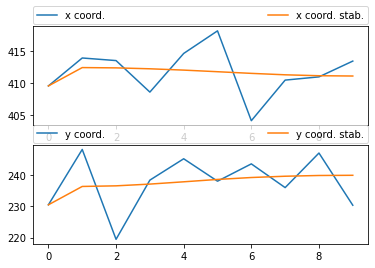

In [ ]:
display_trajectories(im_gray, composed_transforms_est, smooth_composed_transforms_est, n_frames)

### II.2. Real videos

Now that you have tested your code with a synthetic example it is time to evaluate it on real videos with camera shaking. For that you will have to adapt part of the previous code to work with a set of frames extracted from a video.

In particular, you will work with two different videos taken by a moving camera in two different situations:

- A static scene (just background): walking.mp4
- A moving object in a static scene (foregound + background): dancing.mp4

<font color='green'>**T9.** Adapt the previous code to stabilize a given video. Stabilize the two videos provided (walking.mp4 and dancing.mp4) and submit them together with the code. You may reuse the functions used in the first part that read and write a video. Display the original and stabilized trajectories of the middle pixel in both cases (these plots should be displayed also in the report that you submit).</font>

<font color='green'>**OPTIONAL.** Write a new function `crop_and_zoom` that automatically estimates the parameters of the similarity function to apply to every frame (exercise 9 of seminar 4 and section 2.3 in paper [3]) .</font>